In [9]:
import datetime
now = datetime.datetime.now().strftime("%Y/%m/%d %H:%M")
print('=' * 30)
print('version of: {0}'.format(now))
print('=' * 30)

version of: 2020/06/11 13:56


In [10]:
import glob
import os
import sys

from tqdm import tqdm
import numpy as np
import pandas as pd
from sklearn.metrics import log_loss, brier_score_loss
import seaborn as sns; sns.set(style="whitegrid", color_codes=True)

sys.path.append('../..')
from helpers.settings import models_folder, arrays_folder, sheets_folder
from helpers.utils import top_k_accuracy, calculate_confidence, plot_confidence, calculate_error, brier_multi, CalibrationErrors

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

## parameters

In [12]:
n_start_batch = 5
n_selected = 45
architecture = 'densenet169'

## reading arrays

In [13]:
n_ensembles = 10
n_samples = 50000
n_batch = 50
samples_per_batch = n_samples// n_batch
print(samples_per_batch)

1000


In [14]:
n_classes = 1000
y_pred_ensembles = dict()
image_net_model_folder = os.path.join(models_folder, architecture)
os.path.isdir(image_net_model_folder)
y_pred_ensembles = np.zeros((n_ensembles, n_selected*samples_per_batch, n_classes))
X = np.zeros((n_selected*samples_per_batch, 224,224,3), dtype=np.uint8)
y_pred_base = np.zeros((n_selected*samples_per_batch, n_classes))
y_true = np.zeros((n_selected*samples_per_batch, n_classes))

In [ ]:
images_folder = os.path.join(arrays_folder, 'imagenet_224')
image_net_model_folder = os.path.join(models_folder, architecture)
for i in tqdm(range(n_selected)):
    images_path = os.path.join(images_folder, 'x_val_' + str(i+n_start_batch).zfill(3) + '.npy')
    base_path = os.path.join(image_net_model_folder, 'y_pred_base_' + str(i+n_start_batch) + '.npy')
    true_path = os.path.join(image_net_model_folder, 'y_test_' + str(i+n_start_batch) + '.npy')
    ensemble_path = os.path.join(image_net_model_folder, 'y_pred_ensemble_' + str(i+n_start_batch) + '.npy')
    X[i*samples_per_batch: (i+1)*samples_per_batch] = np.load(images_path).astype(np.uint8)
    y_pred_base[i*samples_per_batch: (i+1)*samples_per_batch] = np.load(base_path)
    y_pred_ensembles[:, i*samples_per_batch: (i+1)*samples_per_batch] = np.load(ensemble_path)
    y_true[i*samples_per_batch: (i+1)*samples_per_batch] = np.load(true_path)

 33%|███▎      | 15/45 [00:49<01:43,  3.45s/it]

In [ ]:
output_folder = os.path.join(image_net_model_folder, 'plots')
if not os.path.isdir(output_folder):
    os.mkdir(output_folder)

In [ ]:
import matplotlib
matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['mathtext.rm'] = 'stix'
matplotlib.rcParams['mathtext.it'] = 'stix'
matplotlib.rcParams['mathtext.fontset'] = 'stix'

In [ ]:
df = pd.read_csv(os.path.join(image_net_model_folder, 'golden_optimization_simgas.csv'))
sigma_1 = df[df.iteration == 6].sigma_1.values[0]
sigma_2 = df[df.iteration == 6].sigma_2.values[0]
sigma_optimum = sigma_2 + (sigma_1 - sigma_2) / 2
print('sigma = {0:.2f}'.format(sigma_optimum*1000))

In [ ]:
y_pred_ensemble_mean = np.mean(y_pred_ensembles, axis=0)

In [ ]:
nll_baseline = log_loss(y_true,y_pred_base)
nll_perturbed = log_loss(y_true,y_pred_ensemble_mean)

In [ ]:
k1_base = top_k_accuracy(y_true, y_pred_base)
k5_base = top_k_accuracy(y_true, y_pred_base, 5)
k1 = top_k_accuracy(y_true, y_pred_ensemble_mean)
k5 = top_k_accuracy(y_true, y_pred_ensemble_mean, 5)

In [ ]:
y_pred_base_logit = np.log(y_pred_base)
def softmax(y_logit):
    return np.exp(y_logit)/np.sum(np.exp(y_logit), axis=-1)[:, np.newaxis]
def softmax_t(y_logit, t):
    return np.exp(y_logit/t)/np.sum(np.exp(y_logit/t), axis=-1)[:, np.newaxis]
def ll_t(t):
    y_pred_temp = softmax_t(y_pred_base_logit, t)
    ll = log_loss(y_true, y_pred_temp)
    return ll

In [16]:
temps = pd.read_csv(os.path.join(sheets_folder, 'imagenet_optimal_temps.csv'))
min_t = temps[temps.model==architecture].temp.values[0]
print('optimized temp: {0:.2f}'.format(min_t))
y_pred_temp = softmax_t(y_pred_base_logit, t=min_t)
nll_temp = log_loss(y_true, y_pred_temp)
k1_temp = top_k_accuracy(y_true, y_pred_temp)
k5_temp = top_k_accuracy(y_true, y_pred_temp, 5)

optimized temp: 1.23


In [ ]:
br_baseline = brier_multi(y_true,y_pred_base)
br_temp = brier_multi(y_true,y_pred_temp)
br_perturbed = brier_multi(y_true,y_pred_ensemble_mean)

In [ ]:
print('-'*100)
print('NLL Baseline:{0:.3f}'.format(nll_baseline))
print('NLL Temp: {0:.3f}'.format(nll_temp))
print('NLL PPE: {0:.3f}'.format(nll_perturbed))
print('-'*100)
print('BR Baseline:{0:.3f}'.format(br_baseline))
print('BR Temp: {0:.3f}'.format(br_temp))
print('BR PPE: {0:.3f}'.format(br_perturbed))
print('-'*100)
print('Errors baseline: {0:.2f}, {1:.2f}'.format(100-k1_base, 100-k5_base))
print('Errors Temp: {0:.2f}, {1:.2f}'.format(100-k1_temp, 100-k5_temp))
print('Errors PPE {0:.2f}: {1:.2f}'.format(100-k1, 100-k5))

In [ ]:
y_pred_base_amax = np.amax(y_pred_base, axis=-1)
y_pred_base_argmax = np.argmax(y_pred_base, axis=-1)
y_pred_mean_amax = np.amax(y_pred_ensemble_mean, axis=-1)
y_pred_mean_argmax = np.argmax(y_pred_ensemble_mean, axis=-1)
y_true_argmax = np.argmax(y_true, axis=-1)

In [ ]:
from scipy.stats import ttest_ind

In [ ]:
nll_ensemble_sep = -(np.sum(np.log(y_pred_ensemble_mean)*y_true, axis=1))
nll_baseline_sep = -(np.sum(np.log(y_pred_base)*y_true, axis=1))

In [ ]:
print(np.std(nll_ensemble_sep))
print(np.std(nll_baseline_sep))

In [ ]:
value, pvalue = ttest_ind(nll_ensemble_sep, nll_baseline_sep, equal_var=False)
print(pvalue)

In [20]:
calib_erros = CalibrationErrors(y_true, y_pred_base, bin_size=1 / 20., min_samples=0)
_, _, ece_baseline, mce_baseline, _ = calib_erros.calculate_calibration_errors()
calib_erros = CalibrationErrors(y_true, y_pred_ensemble_mean, bin_size=1 / 20., min_samples=0)
_, _, ece_ppe, mce_ppe, _ = calib_erros.calculate_calibration_errors()
calib_erros = CalibrationErrors(y_true, y_pred_temp, bin_size=1 / 20., min_samples=0)
_, _, ece_temp, mce_temp, _ = calib_erros.calculate_calibration_errors()

In [17]:
from matplotlib import rc
rc('font', **{'family': 'serif', 'sans-serif': ['CMU Serif']})
rc('text', usetex=True)

In [18]:
output_folder = os.path.join(models_folder, 'figure_imagenet')
if not os.path.isdir(output_folder):
    os.mkdir(output_folder)

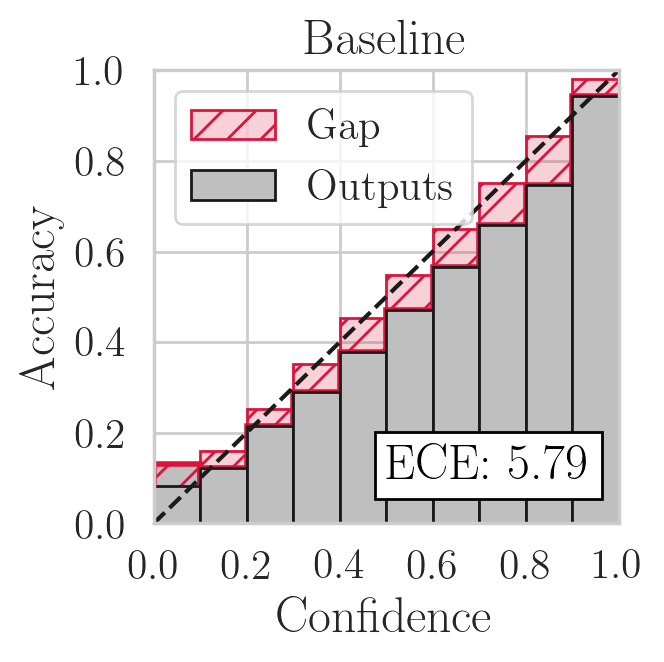

In [25]:
plt.figure(figsize=(3, 3), dpi=200)
ax = plt.subplot(111)
calib_erros = CalibrationErrors(y_true, y_pred_base, bin_size=1 / 10., min_samples=0)
calib_erros.plot_reliability_diagram(ax)
ax.set_title('Baseline', fontsize=18)
ax.set_xlabel('Confidence', fontsize=18)
ax.set_ylabel('Accuracy', fontsize=18)

# ax.text(0.60, 0.05, 'ECE: {0:0.2f}\nMCE: {1:.2f}\nNLL: {2:0.2f}\nBrier: {3:0.2f}'.format(ece_baseline, mce_baseline, nll_baseline, br_baseline),
ax.text(0.5, 0.1, 'ECE: {0:0.2f}'.format(ece_baseline),
        color='black', bbox=dict(facecolor='white', edgecolor='black'), fontsize=18)
output_path = os.path.join(output_folder, 'rel_base.pdf')
plt.savefig(output_path, bbox_inches='tight', pad_inches=0)

/home/mehrtash/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/mehrtash/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


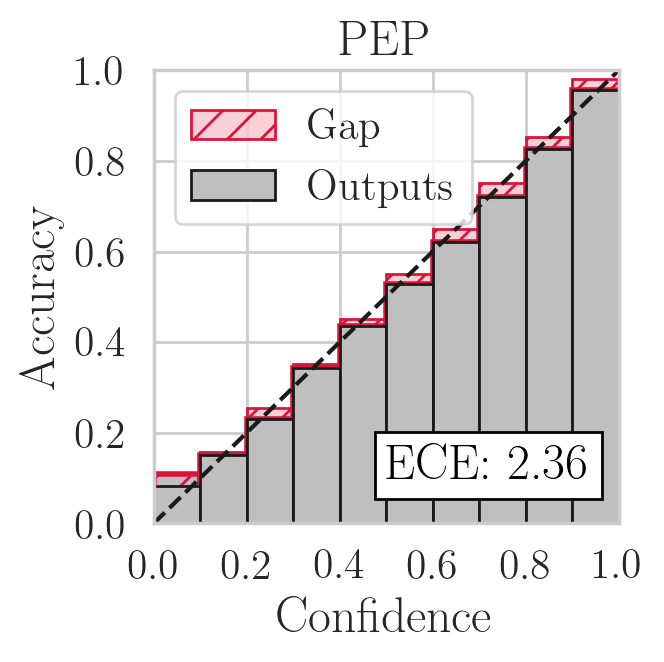

In [24]:
plt.figure(figsize=(3, 3), dpi=200)
ax = plt.subplot(111)
calib_erros = CalibrationErrors(y_true, y_pred_ensemble_mean, bin_size=1 / 10., min_samples=0)
calib_erros.plot_reliability_diagram(ax)
ax.set_title('PEP', fontsize=18)
ax.set_xlabel('Confidence', fontsize=18)
ax.set_ylabel('Accuracy', fontsize=18)

ax.text(0.5, 0.1, 'ECE: {0:0.2f}'.format(ece_ppe),
        color='black', bbox=dict(facecolor='white', edgecolor='black'), fontsize=18)
ax.set_ylabel('Accuracy')
output_path = os.path.join(output_folder, 'rel_epp.pdf')
plt.savefig(output_path, bbox_inches='tight', pad_inches=0)

In [264]:
correct_cases_top_1_ppe = y_pred_mean_argmax == y_true_argmax
correct_cases_top_1_base = y_pred_base_argmax == y_true_argmax

In [265]:
corrected = np.where((correct_cases_top_1_ppe == True) & (correct_cases_top_1_base ==False))[0]
print(corrected.shape)
print(corrected)

(1488,)
[   86   102   150 ... 44951 44954 44964]


In [266]:
print(probs_ppe)

[0.13824387 0.97802579 0.43339574 ... 0.14383656 0.99962025 0.67699469]


In [267]:
probs_ppe = y_pred_ensemble_mean[np.arange(0, y_pred_ensemble_mean.shape[0]), y_true_argmax]
probs_base = y_pred_base[np.arange(0, y_pred_base.shape[0]), y_true_argmax]

In [268]:
probs_ppe

array([0.13824387, 0.97802579, 0.43339574, ..., 0.14383656, 0.99962025,
       0.67699469])

In [269]:
sorted_goh = np.argsort(probs_ppe - probs_base)[::-1]

In [270]:
print(probs_base[sorted_goh[0]])
print(probs_ppe[sorted_goh[0]])

0.12098479270935059
0.8171963214874267


In [271]:
imagenet_classes = pd.read_csv(os.path.join(images_folder, 'keras_ids_to_name.csv'))

In [339]:
selected_indices = sorted_goh[:100]

/home/mehrtash/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/home/mehrtash/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


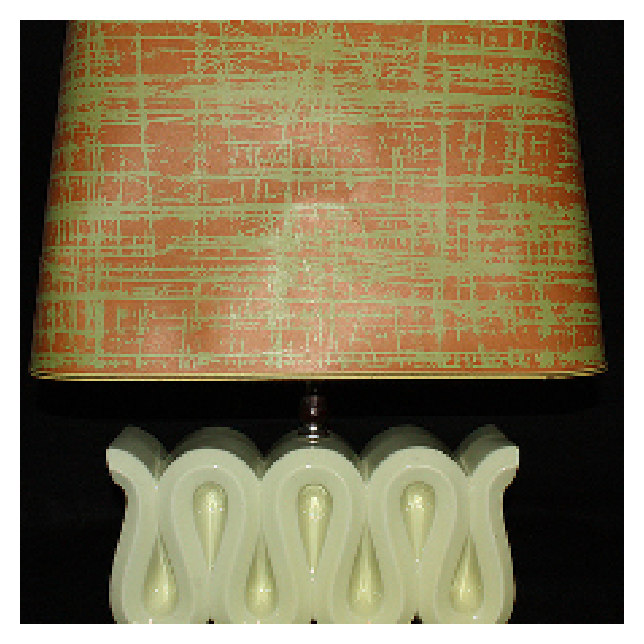

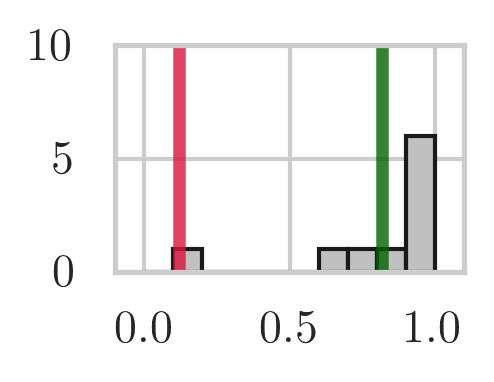

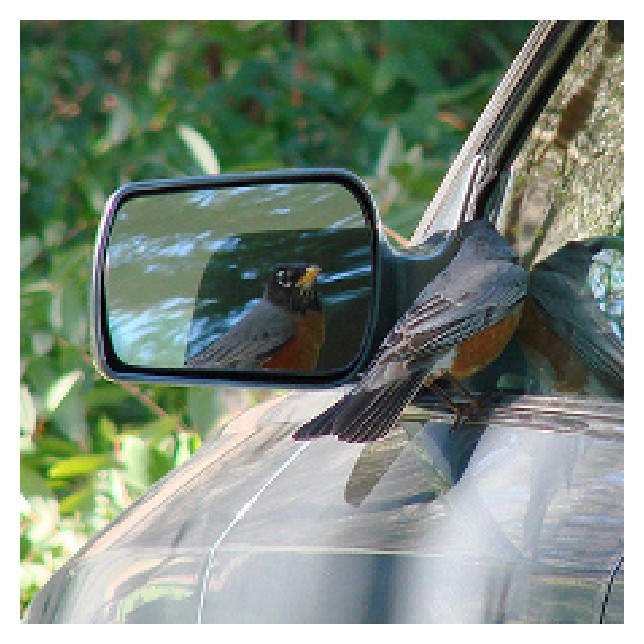

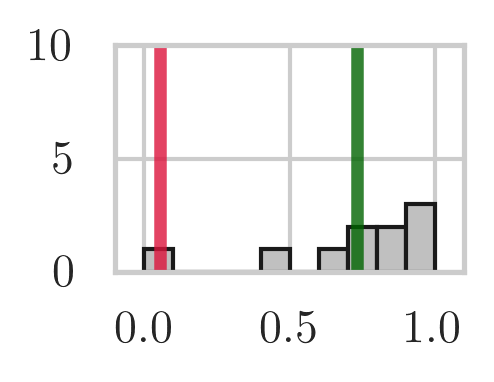

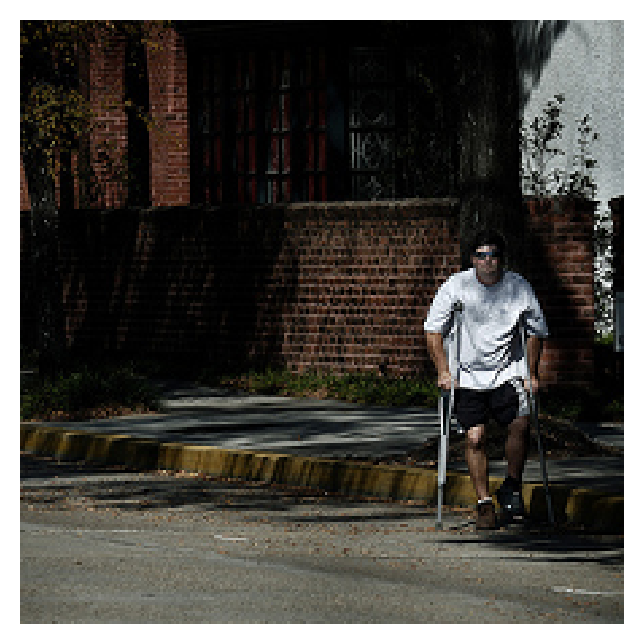

...

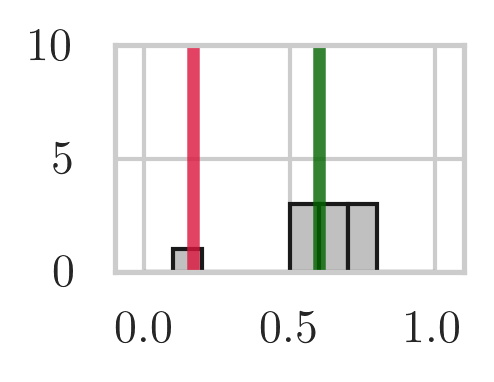

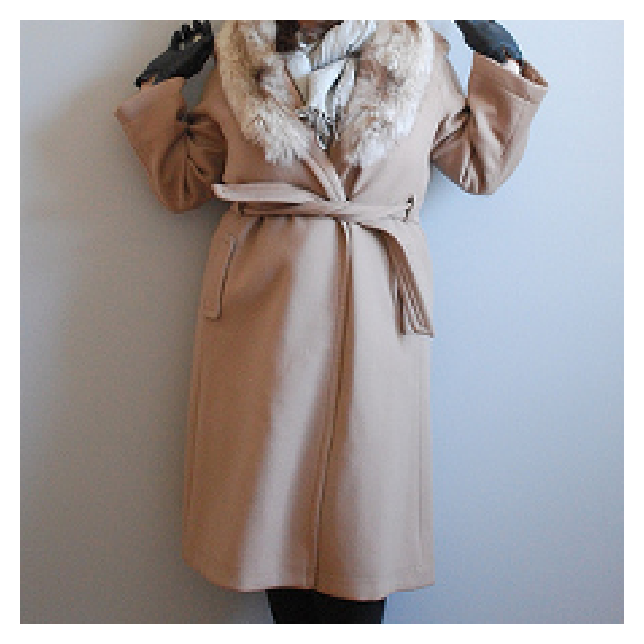

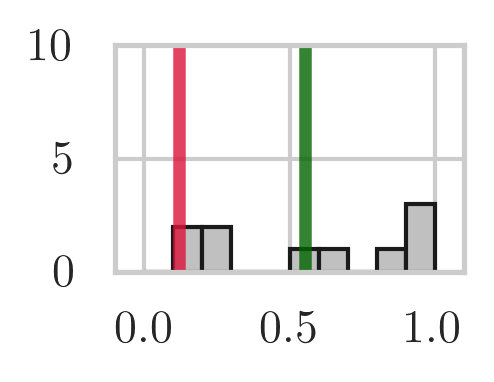

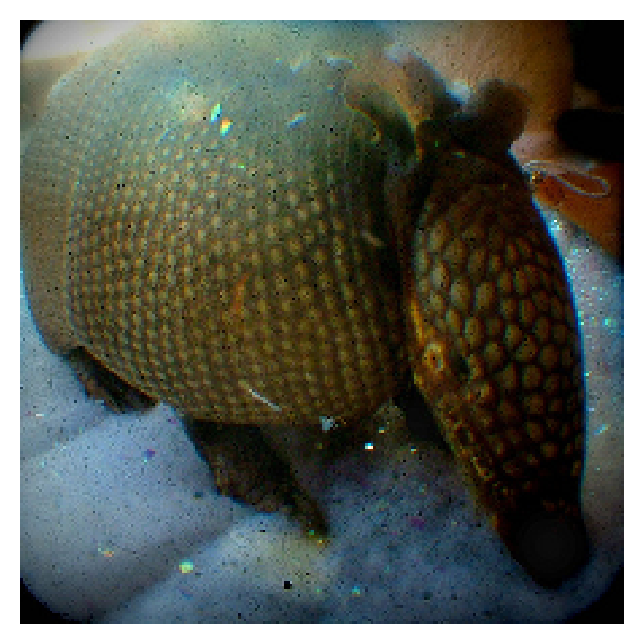

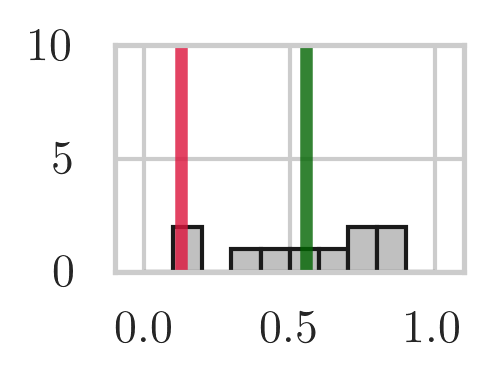

In [340]:
for index in range(len(selected_indices)):
    fig1 = plt.figure(figsize=(4, 4), dpi=200)
    ax1 = plt.subplot(111)
    ax1.imshow(X[selected_indices[index]])
    pred_name = imagenet_classes.loc[y_pred_mean_argmax[selected_indices[index]], 'name'].replace('\n','')
    pred_name = re.sub("(.{18})", "\\1\n", pred_name, 0, re.DOTALL)
    pred_name = pred_name.split(',')[0]
    # plt.suptitle(pred_name)
    ax1.axis('off')
    output_path = os.path.join(output_folder, str(index) + '.png')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
    
    fig2 = plt.figure(figsize=(1.5, 1), dpi=300)
    ax2 = plt.subplot(111)
    newBins = np.arange(0, 1.1,0.1)
    sns.distplot(y_pred_ensembles[:, selected_indices[index], y_pred_mean_argmax[selected_indices[index]]], 
                 kde=False, norm_hist=False, 
                 bins = newBins,
                # bins=10,
                          hist_kws=dict(edgecolor="k", facecolor='silver', lw=1, alpha=1),
                kde_kws=dict(color='k', lw=1, alpha=0.8), ax=ax2)
    prob_base = probs_base[selected_indices[index]]
    prob_ppe = probs_ppe[selected_indices[index]]
    ax2.axvline(prob_base, color='crimson', lw=3, alpha=0.8)
    ax2.axvline(prob_ppe, color='darkgreen', lw=3, alpha=0.8)
    ax2.set_xlim([-0.1,1.1])
    ax2.set_ylim([0,10])
    ax2.set_xticks([0, 0.5, 1])
    ax2.set_yticks([0, 5, 10])
    output_path = os.path.join(output_folder, str(index) + '_probs.png')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0.05)
    # ax2.set_title('{0:.2f} {1:0.2f}'.format(prob_base, prob_ppe))


In [314]:
for index in range(len(selected_indices)):
    true_name = imagenet_classes.loc[y_true_argmax[selected_indices[index]],'name'].replace('\n','')
    true_name = re.sub("(.{18})", "\\1\n", true_name, 0, re.DOTALL)
    pred_name = imagenet_classes.loc[y_pred_mean_argmax[selected_indices[index]], 'name'].replace('\n','')
    pred_name = re.sub("(.{18})", "\\1\n", pred_name, 0, re.DOTALL)
    pred_name_b = imagenet_classes.loc[y_pred_base_argmax[selected_indices[index]], 'name'].replace('\n','')
    pred_name_b = re.sub("(.{18})", "\\1\n", pred_name_b, 0, re.DOTALL)
    print('-'*100)
    print('index {0} changed from ``{1}`` to ``{2}`` (true: {3})'.format(index, pred_name_b, pred_name, true_name))

----------------------------------------------------------------------------------------------------
index 0 changed from ``menu`` to ``lampshade, lamp sh
ade`` (true: lampshade, lamp sh
ade)
----------------------------------------------------------------------------------------------------
index 1 changed from ``robin, American ro
bin, Turdus migrat
orius`` to ``car mirror`` (true: car mirror)
----------------------------------------------------------------------------------------------------
index 2 changed from ``lawn mower, mower`` to ``crutch`` (true: crutch)
----------------------------------------------------------------------------------------------------
index 3 changed from ``hair slide`` to ``corkscrew, bottle 
screw`` (true: corkscrew, bottle 
screw)
----------------------------------------------------------------------------------------------------
index 4 changed from ``brown bear, bruin,
 Ursus arctos`` to ``Irish terrier`` (true: Irish terrier)
------------------------